# Data Preparation Tutorial - Kidney Visium

Spatial-Live primarily centers around data visualization, with less emphasis on data processing. However, to effectively utilize Spatial-Live, it's essential to supply appropriately formatted input files. This tutorial aims to illustrate the process of preparing these input files for the "A quick demo" showcased earlier. Specifically tailored to the 10X Visium platform, this demo serves as a valuable reference when configuring your own data visualization settings.

## Python virtual environment setup

In order to run this Jupyter Notebook and streamline the process for your convenience, we have compiled several supplementary files including "requirements.txt", which you can use to easily set up a Python virtual environment. 

In [1]:
# Please git clone the spatial-live from github, 
# and change the WORKROOTDIR to your own working directory
%env WORKROOTDIR=/Users/zhenqingye/projects/spatial-live

env: WORKROOTDIR=/Users/zhenqingye/projects/spatial-live


In [2]:
# You can use the below requirements.txt to create your virtual environment
! tree -L 1 ${WORKROOTDIR}/quickdemo/

/Users/zhenqingye/projects/spatial-live/quickdemo/
├── kidney
├── liver
└── requirements.txt

2 directories, 1 file


## 10X Visium spatial data preparation

The original data was downloaded from [the kidney paper](https://insight.jci.org/articles/view/147703) (GEO: [GSM5224981](https://www.ncbi.nlm.nih.gov/geo/query/acc.cgi?acc=GSM5224981)), and we processed the raw data by the software tool [Space Ranger](https://support.10xgenomics.com/spatial-gene-expression/software/pipelines/latest/what-is-space-ranger) from 10X website. The important outcomes have been saved in the "quickdemo/kidney" folder for our current purpose.

In [3]:
! tree ${WORKROOTDIR}/quickdemo/kidney/

/Users/zhenqingye/projects/spatial-live/quickdemo/kidney/
└── Visium
    └── outs
        ├── filtered_feature_bc_matrix.h5
        └── spatial
            ├── aligned_fiducials.jpg
            ├── detected_tissue_image.jpg
            ├── scalefactors_json.json
            ├── tissue_hires_image.png
            ├── tissue_lowres_image.png
            └── tissue_positions_list.csv

3 directories, 7 files


In [4]:
import warnings
warnings.simplefilter('ignore')

import os
import numpy as np
import matplotlib.pyplot as plt
import scanpy as sc 
import squidpy as sq
import pandas as pd
import PIL

pd.options.display.precision=3

sc.logging.print_header()

scanpy==1.9.5 anndata==0.9.2 umap==0.5.4 numpy==1.23.4 scipy==1.11.2 pandas==2.1.0 scikit-learn==1.3.0 statsmodels==0.14.0 igraph==0.10.8 pynndescent==0.5.10


## Preprocessing and quality control
Again, please change the rootdir to your working directory accordingly.

In [5]:
rootdir = "/Users/zhenqingye/projects/spatial-live/"

library_id = "Visium"
datadir = rootdir + 'quickdemo/kidney/' 

In [6]:
print(datadir)

/Users/zhenqingye/projects/spatial-live/quickdemo/kidney/


In [7]:
adata = sc.read_visium(datadir + library_id + '/outs/', library_id=library_id)
adata.var_names_make_unique()
adata.obs.head(3)

,in_tissue,array_row,array_col
AAACAAGTATCTCCCA-1,1,50,102
AAACACCAATAACTGC-1,1,59,19
AAACAGCTTTCAGAAG-1,1,43,9


In [8]:
adata.shape

(1889, 32285)

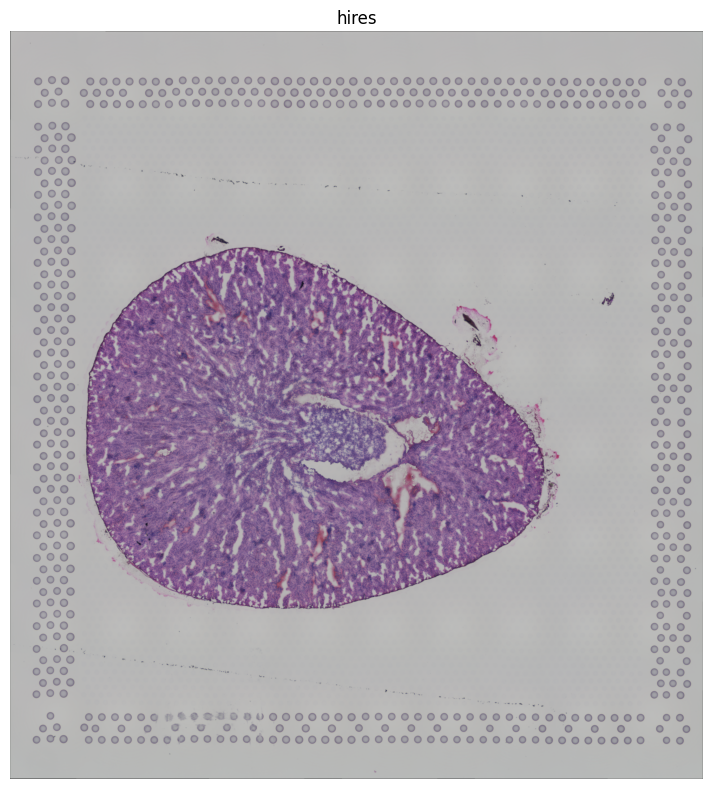

In [9]:
imgContainer = sq.im.ImageContainer.from_adata(adata)
imgContainer.show(layer='hires')

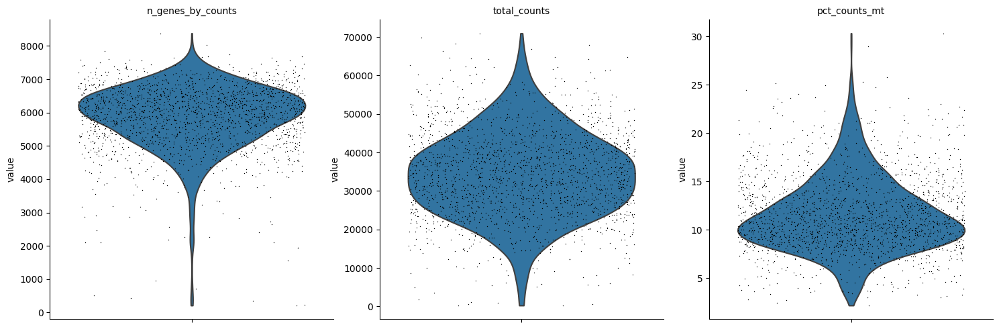

In [10]:
adata.var["mt"] = adata.var_names.str.startswith('mt-')
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt"], inplace=True)
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'], jitter=0.4, multi_panel=True, rotation=45)

In [11]:
#keep in mind that here cells are actually spots
sc.pp.filter_cells(adata, min_genes=100, inplace=True)
sc.pp.filter_genes(adata, min_cells=10,  inplace=True)
adata.shape

(1889, 15634)

In [12]:
adata.obs.head(3)

,in_tissue,array_row,array_col,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,log1p_total_counts_mt,pct_counts_mt,n_genes
AAACAAGTATCTCCCA-1,1,50,102,6206,8.733,37805.0,10.540,34.744,40.804,48.954,62.415,5914.0,8.685,15.643,6206
AAACACCAATAACTGC-1,1,59,19,4693,8.454,20990.0,9.952,34.359,40.629,49.123,63.016,3089.0,8.036,14.717,4693
AAACAGCTTTCAGAAG-1,1,43,9,5887,8.681,41463.0,10.633,34.428,41.357,50.397,65.058,3571.0,8.181,8.612,5887


In [13]:
sc.pp.normalize_total(adata, target_sum=1e5, inplace=True)
sc.pp.log1p(adata)

## Highly variable genes and leiden clustering

In this section, we will continue the classical analysis for this single-cell data, namely go through highly virable gene filtering, PCA dimention reduction, as well as leiden clustering.


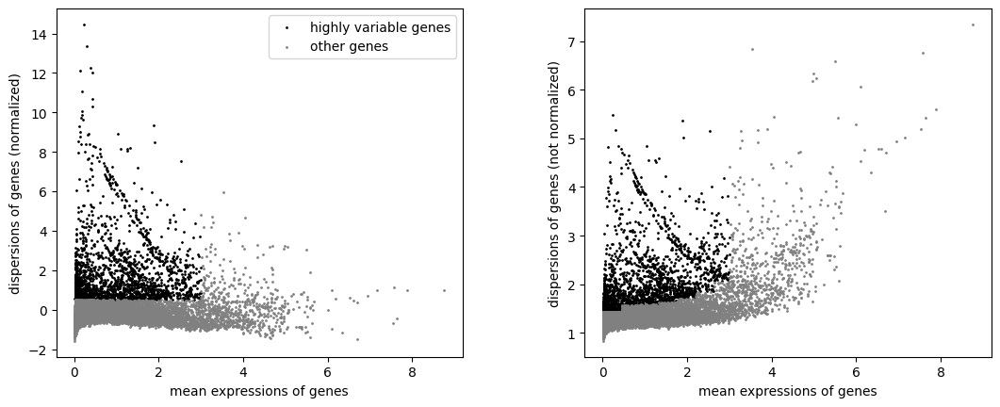

In [14]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata)

In [15]:
#we will keep original data into the raw variable for future using
adata.raw = adata

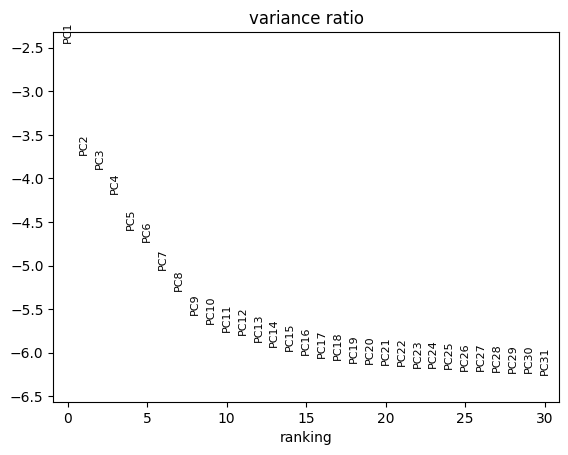

In [16]:
adata = adata[:, adata.var.highly_variable]
sc.pp.scale(adata, max_value=10)
sc.tl.pca(adata, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata, log=True)

Dimensionality Reduction, Neighbor Calculation, and Clustering

In [17]:
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=12)
sc.tl.leiden(adata,resolution=0.5)
sc.tl.umap(adata)

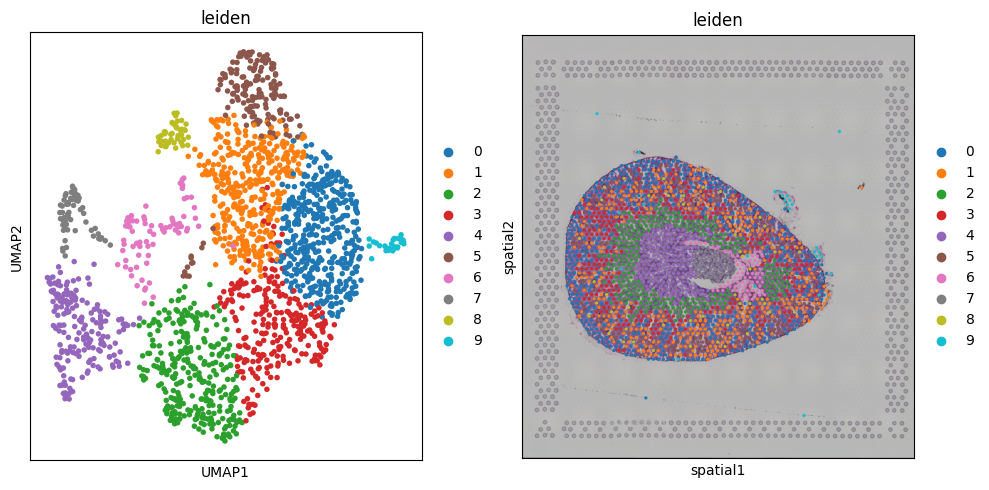

In [18]:
fig, axs = plt.subplots(1, 2, figsize=(10, 5))
sc.pl.umap(adata, color='leiden', ax=axs[0], show=False)
sq.pl.spatial_scatter(adata, color=['leiden'], ax=axs[1])
fig.tight_layout()

### Finding marker genes
We will proceed to calculate a ranking for highly differential genes within each leiden group.

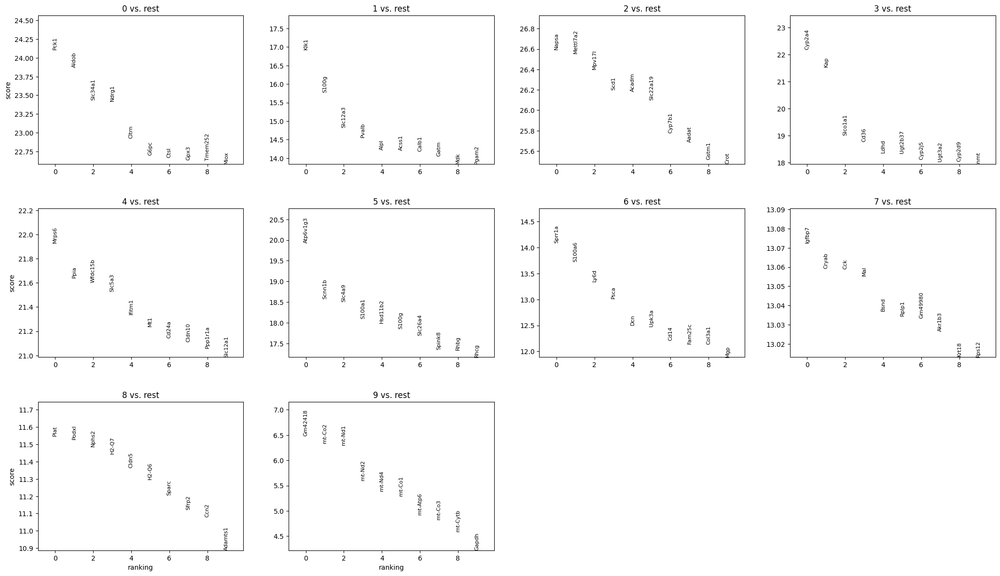

In [19]:
sc.tl.rank_genes_groups(adata, groupby="leiden", method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=10, sharey=False)

In [20]:
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(10)

,0,1,2,3,4,5,6,7,8,9
0,Pck1,Klk1,Napsa,Cyp2a4,Mrps6,Atp6v1g3,Sprr1a,Igfbp7,Plat,Gm42418
1,Aldob,S100g,Mettl7a2,Kap,Ppia,Scnn1b,S100a6,Cryab,Podxl,mt-Co2
2,Slc34a1,Slc12a3,Mpv17l,Slco1a1,Wfdc15b,Slc4a9,Ly6d,Cck,Nphs2,mt-Nd1
3,Ndrg1,Pvalb,Scd1,Cd36,Slc5a3,S100a1,Psca,Mal,H2-Q7,mt-Nd2
4,Cltrn,Alpl,Acadm,Ldhd,Ifitm1,Hsd11b2,Dcn,Bsnd,Cldn5,mt-Nd4
5,G6pc,Acss1,Slc22a19,Ugt2b37,Mt1,S100g,Upk3a,Rplp1,H2-Q6,mt-Co1
6,Ctsl,Calb1,Cyp7b1,Cyp2j5,Cd24a,Slc26a4,Cd14,Gm49980,Sparc,mt-Atp6
7,Gpx3,Gatm,Aadat,Ugt3a2,Cldn10,Spink8,Fam25c,Akr1b3,Sfrp2,mt-Co3
8,Tmem252,Mdk,Gstm1,Cyp2d9,Ppp1r1a,Rhbg,Col3a1,Krt18,Ccn2,mt-Cytb
9,Miox,Pgam2,Crot,Inmt,Slc12a1,Rhcg,Mgp,Rps12,Adamts1,Gapdh


## Preparing input files for Spatial-Live

In this section, we prepare the necessary data columns for the Spatial-Live input CSV file. This includes a core set of columns, namely "id:barcode", "pos:pixel_x" and "pos:pixel_y". Additionally, we aim to incorporate several supplementary variables:

* A categorical variable labeled "char:leiden".
* Two numerical variables: "num:Sprr1a" (representing the top gene from leiden-6 group) and "num:Plat" (representing the top gene from leiden-8 group).
* Two gene variabels: "gene:Cryab" (the second-highest gene from leiden-7 group) and "gene:Mrps6" (representing the top gene from leiden-4 group) for heatmap plotting.
  
While gene variable data is inherently numerical, it undergoes a slightly different data processing approach in Spatial-Live, distinguishing it from standard numerical variables and warranting a distinct mention.

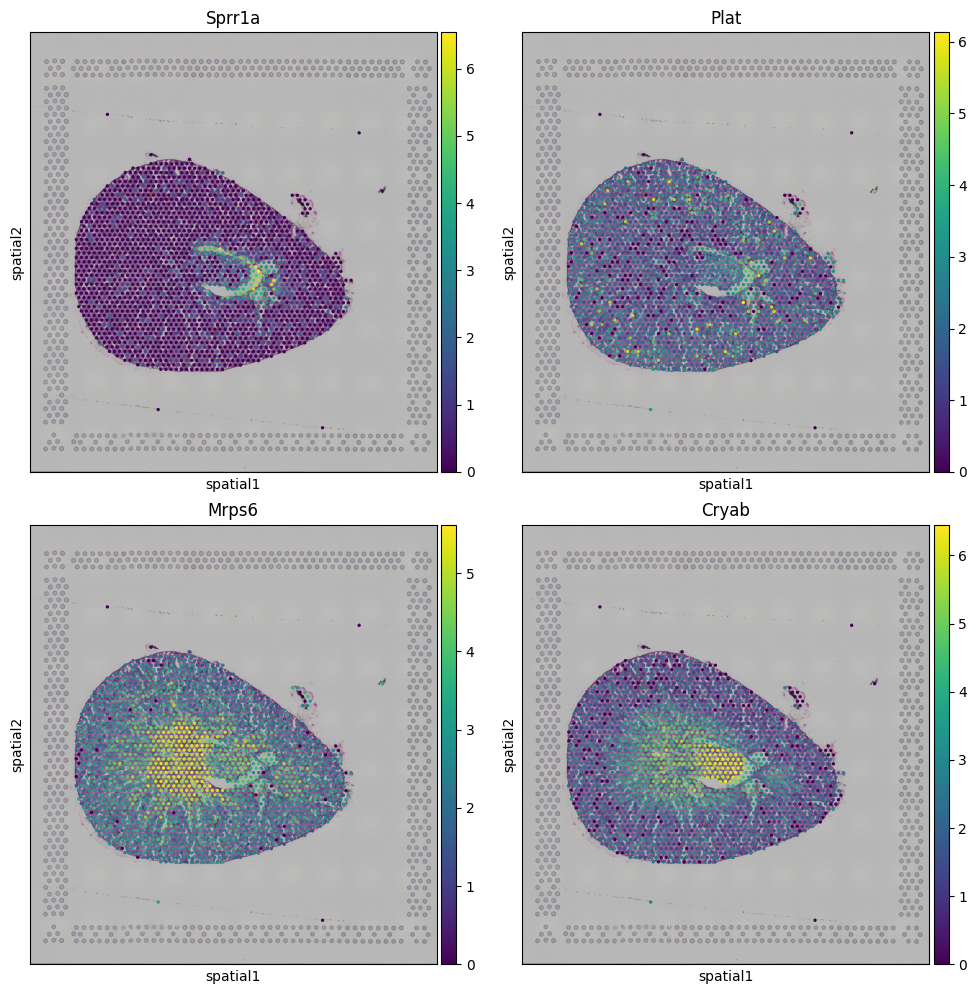

In [21]:
fig, axs = plt.subplots(2, 2, figsize=(10, 10))
sq.pl.spatial_scatter(adata, color=['Sprr1a'], ax=axs[0,0], use_raw=True)
sq.pl.spatial_scatter(adata, color=['Plat'],  ax=axs[0,1], use_raw=True)
sq.pl.spatial_scatter(adata, color=['Mrps6'], ax=axs[1,0], use_raw=True)
sq.pl.spatial_scatter(adata, color=['Cryab'], ax=axs[1,1])
fig.tight_layout()

We can extract these values from adata object now

In [22]:
csv_out_df = sc.get.obs_df(adata, keys=['leiden', 'Sprr1a', 'Plat', 'Mrps6', 'Cryab'], use_raw=True)
csv_out_df.head(3)

,leiden,Sprr1a,Plat,Mrps6,Cryab
AAACAAGTATCTCCCA-1,1,1.293,2.971,2.826,2.449
AAACACCAATAACTGC-1,1,1.752,2.728,3.212,0.000
AAACAGCTTTCAGAAG-1,3,0.000,1.227,2.365,1.762


To extract the positions of each cell (spot) in pixel space, it's crucial to be mindful of the image employed. In our scenario, we exclusively use the "hires" version of the image for all preceding visualizations. As a result, we will persist in utilizing the "hires" image to compute the pixel positions of each cell. Additionally, it's essential to account for disparities in the origin points (left, up) between the image coordinate system and the Spatial-Live pixel coordinate system (left, bottom).

In [23]:
hires_sf = adata.uns['spatial'][library_id]['scalefactors']['tissue_hires_scalef']
hires_maxY = imgContainer.shape[0]
csv_out_df['pixel_x'] = adata.obsm['spatial'][:,0] * hires_sf
# csv_out_df['pixel_y'] = adata.obsm['spatial'][:,1] * hires_sf
# translate the origin point (Y-axis) to be consistent with the spatial-lvv pixel coordinate
csv_out_df['pixel_y'] = hires_maxY - adata.obsm['spatial'][:,1] * hires_sf

csv_out_df.head(3)

,leiden,Sprr1a,Plat,Mrps6,Cryab,pixel_x,pixel_y
AAACAAGTATCTCCCA-1,1,1.293,2.971,2.826,2.449,1392.051,750.288
AAACACCAATAACTGC-1,1,1.752,2.728,3.212,0.000,421.528,569.532
AAACAGCTTTCAGAAG-1,3,0.000,1.227,2.365,1.762,305.391,895.105


And we further change the column names to comply with the rules from Spatial-Live, refer to the documents.

In [24]:
csv_out_df.rename(columns={
                    "leiden":  "char:leiden", 
                    "Sprr1a":  "num:Sprr1a",
                    "Plat":    "num:Plat",
                    "Mrps6":   "gene:Mrps6",
                    "Cryab":   "gene:Cryab",
                    "pixel_x": "pos:pixel_x",
                    "pixel_y": "pos:pixel_y"
                  }, inplace=True)
csv_out_df.head(3)

,char:leiden,num:Sprr1a,num:Plat,gene:Mrps6,gene:Cryab,pos:pixel_x,pos:pixel_y
AAACAAGTATCTCCCA-1,1,1.293,2.971,2.826,2.449,1392.051,750.288
AAACACCAATAACTGC-1,1,1.752,2.728,3.212,0.000,421.528,569.532
AAACAGCTTTCAGAAG-1,3,0.000,1.227,2.365,1.762,305.391,895.105


Now we will output the image (png file) and formated data sheet (csv file) to the target folder, which can be accessed from the Spatial-Live visualization tool.

In [25]:
! mkdir -p ${WORKROOTDIR}/quickdemo/kidney/output

In [26]:
img = np.squeeze(imgContainer['hires'])
img = PIL.Image.fromarray((img.to_numpy()*255).astype('uint8'))
img.save(datadir + "output/kidney_demo.png")

In [27]:
csv_out_df.to_csv(datadir + "output/kidney_demo.csv", index_label="id:spot", float_format='%.3f')

In [28]:
! tree ${WORKROOTDIR}/quickdemo/kidney/

/Users/zhenqingye/projects/spatial-live/quickdemo/kidney/
├── Visium
│   └── outs
│       ├── filtered_feature_bc_matrix.h5
│       └── spatial
│           ├── aligned_fiducials.jpg
│           ├── detected_tissue_image.jpg
│           ├── scalefactors_json.json
│           ├── tissue_hires_image.png
│           ├── tissue_lowres_image.png
│           └── tissue_positions_list.csv
└── output
    ├── kidney_demo.csv
    └── kidney_demo.png

4 directories, 9 files


Notice that the two files (kidney_demo.csv and kidney_demo.png) have been stored in the "output" folder. And here we also briefly check the header and a few first rows in the kidney_demo.csv as below to see if it is compatible with the requirement from Spatial-Live.

In [29]:
! head ${WORKROOTDIR}/quickdemo/kidney/output/kidney_demo.csv

id:spot,char:leiden,num:Sprr1a,num:Plat,gene:Mrps6,gene:Cryab,pos:pixel_x,pos:pixel_y
AAACAAGTATCTCCCA-1,1,1.293,2.971,2.826,2.449,1392.051,750.288
AAACACCAATAACTGC-1,1,1.752,2.728,3.212,0.000,421.528,569.532
AAACAGCTTTCAGAAG-1,3,0.000,1.227,2.365,1.762,305.391,895.105
AAACAGGGTCTATATT-1,1,0.000,3.311,3.006,2.361,351.952,813.667
AAACCGGGTAGGTACC-1,2,1.200,1.730,3.859,3.996,527.397,914.933
AAACCGTTCGTCCAGG-1,2,0.000,1.763,2.630,3.830,690.626,711.162
AAACCTCATGAAGTTG-1,2,0.000,1.385,4.247,2.771,422.413,1016.907
AAACGAGACGGTTGAT-1,1,1.642,2.602,3.407,1.642,1123.838,1056.033
AAACTGCTGGCTCCAA-1,7,4.083,3.258,3.932,5.884,983.093,852.970


## Geometric Json file

In the following step, we'll focus on generating the geometric JSON file. While this file is not mandatory for Spatial-Live, it can prove advantageous in certain scenarios. For instance, it comes in handy when annotating regions of interest (ROIs) on the image. For the more details, please refer to [GeoJson specification](https://geojson.org/). Within the "properties" section, each feature necessitates two key attributes: "id" and "group." It's worth noting that multiple JSON files are supported, and they should all be placed in the designated "json" folder.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
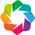

In [30]:
import holoviews as hv
from holoviews import opts, streams
from PIL import Image
import geojson

hv.extension('bokeh')

In [31]:
img_uri = rootdir + 'quickdemo/kidney/Visium/outs/spatial/tissue_hires_image.png'
imarray = np.array(Image.open(img_uri).convert('RGBA'))
imarray.shape

(2000, 1853, 4)

In [32]:
IMG_HEIGHT, IMG_WIDTH = imarray.shape[0:2]

#flip to be consistent with the spatial-live coordinates
imarray = np.flip(imarray, axis=0)  

hvimg = hv.RGB(imarray, bounds=(0, 0,  IMG_WIDTH, IMG_HEIGHT))

### Simple geometric polygons for JSON layer

During an active Jupyter server session, we have the capability to both edit and extract these polygons. However, in the context of a static HTML Sphinx document, the interactive real-time extraction of these polygons is not feasible. As a result, we have preconfigured these simple polygons and hardcoded them in this notebook for the sake of reproducibility and demonstration. 

In [33]:
# notice that the origin of the image in Bokeh plot is different from the origin in spatial-live coordinates,
# Therefore we need to transform it a little bit here to make them consistent

pg1 = {'x': np.array([381.96, 343.73, 622.3]), 'y': IMG_HEIGHT - np.array([760.15, 952.1, 923.95]) }
pg2 = {'x': np.array([803.69, 785.31, 960.61, 975.25, 921.99]), 'y': IMG_HEIGHT - np.array([872.77, 1002.79,965.38, 866.29, 832.04]) }
pg3 = {'x': np.array([1042.96, 1012.11, 1160.95, 1153.65]), 'y': IMG_HEIGHT - np.array([1043.75, 1189.68, 1132.59, 998.19]) }
mypolys = hv.Polygons([pg1, pg2, pg3])

#mypolys = hv.Polygons([])

In [34]:
# need to be set before poly_stream
poly_edit = streams.PolyEdit(source=mypolys, vertex_style={'color': 'red'}, shared=True)  

poly_stream = streams.PolyDraw(source=mypolys, drag=True, num_objects=4,
                               show_vertices=True, styles={
                                   'fill_color': ['red', 'green', 'blue']
                               })

layout = hvimg *  mypolys
layout.opts(
    opts.Polygons( fill_alpha=0.4, height=500, width=500 ),
    opts.RGB(height=500, width=500),
)

:Overlay
   .RGB.I      :RGB   [x,y]   (R,G,B,A)
   .Polygons.I :Polygons   [x,y]

We can output these geometric shapes into a json file now.

In [35]:
geojson.geometry.DEFAULT_PRECISION = 2

def output_geojson(data, features=None, groups=None):
    collection = []
    for i, (xs, ys, c) in enumerate( zip(data['xs'], data['ys'], data['fill_color']) ):
        points = [ ( x, IMG_HEIGHT - y) for x, y in zip(xs, ys) ]
        # points = [ ( x, y) for x, y in zip(xs, ys) ]
        polygon = geojson.Polygon([points])
        if(features != None and groups != None):
            properties = {'id': features[i], 'group': groups[i]}
        else:
            properties = {'id': 'feature-'+str(i+1), 'group': 'grp-'+str(i+1)}
        feature = geojson.Feature(geometry=polygon, properties=properties)
        collection.append(feature)
    return geojson.FeatureCollection(collection)

In [36]:
features = ['feature-1', 'feature-2', 'feature-3']
groups = ['group-1', 'group-2', 'group-3']
collection = output_geojson(poly_stream.data, features, groups)

if not os.path.exists(datadir + 'output/json'):
    os.mkdir(datadir + 'output/json')
    
geojson.dump(collection, open(datadir + "output/json/ROI_kidney.json", 'w'), sort_keys=True) 

In [37]:
! tree ${WORKROOTDIR}/quickdemo/kidney/output/

/Users/zhenqingye/projects/spatial-live/quickdemo/kidney/output/
├── json
│   └── ROI_kidney.json
├── kidney_demo.csv
└── kidney_demo.png

1 directory, 3 files


In [38]:
! python -m json.tool ${WORKROOTDIR}/quickdemo/kidney/output/json/ROI_kidney.json

{
    "features": [
        {
            "geometry": {
                "coordinates": [
                    [
                        [
                            381.96,
                            760.15
                        ],
                        [
                            343.73,
                            952.1
                        ],
                        [
                            622.3,
                            923.95
                        ],
                        [
                            381.96,
                            760.15
                        ]
                    ]
                ],
                "type": "Polygon"
            },
            "properties": {
                "group": "group-1",
                "id": "feature-1"
            },
            "type": "Feature"
        },
        {
            "geometry": {
                "coordinates": [
                    [
                        [
                            803.69,

### Polygons for Leiden cluster's boundary

In the previous example, we used simple polygons for the sake of demonstration. Now, we'd like to showcase how Spatial-Live can handle multiple JSON files. As observed in the Leiden clustering section, we can identify several clusters that correspond to distinct kidney anatomical regions (please refer to: https://ntp.niehs.nih.gov/atlas/nnl/urinary-system/kidney). For instance, cluster 7 represents the inner medulla, cluster 4 relates to the ISOM (inner stripe of the outer medulla), cluster 2 corresponds to the OSOM (outer stripe of the outer medulla), and the remaining areas are likely associated with the cortex. To simplify this process, we have roughly hardcoded regions based on the positions of boundary cells and created corresponding polygons for each of these regions.


In [39]:
c7_node_xs = [854.92, 878.29, 889.97, 913.34, 936.71, 948.39, 971.76, 983.27, 994.95, 1006.64, 994.95, 983.09, 959.72, 948.04, 924.67, 
              901.30, 889.62, 866.25, 842.88, 831.19, 819.69, 808.00, 819.69, 831.37, 819.86, 843.23]
c7_node_ys = [1004.34, 1004.51, 1024.87, 1024.87, 1024.87, 1045.23, 1045.41, 1065.77, 1086.13, 1106.49, 1126.67, 1147.03, 1147.03, 
              1167.39, 1167.21, 1167.21, 1146.85, 1146.85, 1146.68, 1126.32, 1105.96, 1085.60, 1065.42, 1045.06, 1024.70, 1024.70]

pg1 = {'x': np.array(c7_node_xs), 'y':  np.array(c7_node_ys)}

c4_node_xs = [796.67, 773.30, 761.62, 738.25, 714.88, 703.20, 679.83, 668.14, 644.77, 621.40, 609.54, 586.17, 574.49, 562.80, 574.31, 
          562.63, 574.31, 562.63, 550.77, 539.08, 550.77, 539.08, 562.45, 573.96, 585.64, 597.33, 609.01, 632.38, 644.065, 655.75,
          679.12, 702.49, 725.86, 737.54, 749.23, 772.59, 795.96, 819.33, 842.70, 866.07, 877.76, 854.39, 831.02, 819.51, 796.14,
          784.46, 796.14, 819.51, 807.83, 796.32, 784.63, 796.32, 808.00, 796.49, 808.18, 784.81, 761.44, 749.76, 761.44, 784.81,
          808.18, 831.55, 820.04]
 
c4_node_ys = [943.26, 943.26, 922.90, 922.72, 922.72, 902.36, 902.36, 922.72, 922.55, 922.55, 942.91, 942.73, 963.09, 983.45, 1003.81, 
           1024.17, 1044.53, 1064.71, 1085.07, 1105.43, 1125.79, 1146.14, 1146.14, 1166.50, 1186.86, 1207.22, 1186.86, 1186.86, 
           1207.40, 1227.76, 1227.76, 1227.76, 1227.76, 1248.12, 1227.94, 1227.94, 1227.94, 1228.11, 1228.11, 1228.11, 1207.75, 
           1207.75, 1207.75, 1187.39, 1187.39, 1167.04, 1146.68, 1146.68, 1126.32, 1105.96, 1085.60, 1065.24, 1045.06, 1024.70, 
           1004.34, 1004.34, 1004.16, 983.80, 963.44, 963.62, 963.62, 963.62, 943.26]

pg2 = {'x': np.array(c4_node_xs), 'y':  np.array(c4_node_ys)}



c2_node_xs = [527.40, 539.26, 550.94, 539.26, 550.94, 539.44, 551.12, 562.80, 574.49, 598.03, 609.72, 633.09, 656.46, 668.14, 
              691.51, 714.88, 726.56, 749.93, 773.30, 784.99, 808.36, 831.73, 843.41, 866.78, 878.29, 889.97, 913.34, 936.71, 
              948.39, 971.76, 995.13, 1006.82, 1018.50, 1030.18, 1053.73, 1042.05, 1018.68, 1006.82, 983.45, 960.08, 948.57, 
              960.25, 936.89, 913.52, 901.83, 913.52, 902.01, 878.64, 866.96, 855.09, 831.73, 808.36, 784.99, 761.62, 750.11, 
              738.43, 715.06, 691.69, 680.00, 656.63, 644.95, 633.27, 644.95, 633.09, 609.72, 586.35, 562.98, 551.30, 527.93, 
              516.24, 504.56, 492.87, 469.51, 446.14, 457.64, 469.33, 457.64, 434.27, 422.41, 445.96, 457.47, 480.84, 492.52, 
              480.84, 457.47, 434.10, 445.61, 433.92, 410.55, 398.87, 422.24, 445.61, 457.29, 480.66, 492.34, 480.66, 468.97, 
              445.43, 433.74, 457.11, 468.80, 480.48, 468.62, 445.25, 456.94, 480.30, 491.99, 503.67, 527.04, 550.41, 562.10, 
              550.41, 573.78, 585.47, 597.15, 620.52, 643.89, 667.26, 690.63, 702.31, 725.68, 737.36, 760.73, 772.42, 795.79, 
              807.47, 830.84, 854.21, 877.58, 889.44, 866.07, 854.39, 831.02, 807.65, 784.28, 760.91, 749.05, 737.36, 713.99, 
              702.31, 714.17, 690.80, 667.43, 644.06, 632.38, 620.70, 609.01, 585.64, 573.96, 562.27, 550.59, 527.22, 515.71, 
              527.40, 515.71]
c2_node_ys = [1085.07, 1064.71, 1044.35, 1023.99, 1003.81, 983.45, 963.09, 942.73, 922.37, 922.55, 902.19, 902.19, 902.36, 
              882.00, 882.00, 882.00, 902.36, 902.54, 902.54, 922.90, 922.90, 923.08, 943.44, 943.44, 963.80, 984.16, 984.15, 
              984.33, 1004.69, 1004.69, 1004.69, 1025.05, 1004.69, 984.51, 984.51, 964.15, 964.15, 984.33, 984.33, 984.33, 
              963.97, 943.61, 943.61, 943.61, 923.08, 902.89, 882.54, 882.36, 861.99, 882.36, 882.36, 882.36, 882.18, 882.18, 
              861.82, 841.46, 841.46, 841.29, 820.93, 820.93, 800.57, 820.93, 841.29, 861.64, 861.47, 861.47, 861.47, 881.65, 
              881.65, 861.29, 881.65, 901.83, 901.83, 901.83, 922.19, 942.55, 962.91, 962.73, 983.09, 983.09, 1003.45, 1003.63, 
              1023.99, 1044.17, 1044.17, 1044.17, 1064.53, 1084.89, 1084.71, 1105.07, 1105.07, 1105.25, 1084.89, 1084.89, 1105.25, 
              1125.61, 1145.97, 1145.79, 1166.15, 1166.15, 1186.51, 1206.87, 1227.23, 1227.23, 1247.59, 1247.59, 1267.95, 1247.76, 
              1247.76, 1247.76, 1268.12, 1288.48, 1288.48, 1308.84, 1288.48, 1288.66, 1288.66, 1288.66, 1288.84, 1309.20, 1309.20, 
              1329.56, 1329.56, 1309.20, 1309.37, 1289.01, 1289.01, 1289.19, 1289.19, 1268.83, 1268.83, 1248.47, 1248.47, 1248.30, 
              1248.30, 1248.30, 1268.48, 1288.84, 1288.84, 1268.48, 1248.12, 1248.12, 1248.12, 1247.94, 1227.58, 1207.22, 1227.58, 
              1227.58, 1207.22, 1186.86, 1166.50, 1166.33, 1145.97, 1125.79, 1105.43]
 
pg3 = {'x': np.array(c2_node_xs), 'y': np.array(c2_node_ys)}

mypolys = hv.Polygons([pg1, pg2, pg3])

In [40]:
# need to be set before poly_stream
poly_edit = streams.PolyEdit(source=mypolys, vertex_style={'color': 'red'}, shared=True)  

poly_stream = streams.PolyDraw(source=mypolys, drag=True, num_objects=4,
                               show_vertices=True, styles={
                                   'fill_color': ['red', 'green', 'blue']
                               })

layout = hvimg *  mypolys
layout.opts(
    opts.Polygons( fill_alpha=0.4, height=600, width=600 ),
    opts.RGB(height=600, width=600),
)

:Overlay
   .RGB.I      :RGB   [x,y]   (R,G,B,A)
   .Polygons.I :Polygons   [x,y]

In [41]:
features = ['Medulla', 'ISOM', 'OSOM']
groups = ['c-7', 'c-4', 'c-2']
collection = output_geojson(poly_stream.data, features, groups)

if not os.path.exists(datadir + 'output/json'):
    os.mkdir(datadir + 'output/json')
    
geojson.dump(collection, open(datadir + "output/json/leiden_kidney.json", 'w'), sort_keys=True) 

In [42]:
! tree ${WORKROOTDIR}/quickdemo/kidney/output/

/Users/zhenqingye/projects/spatial-live/quickdemo/kidney/output/
├── json
│   ├── ROI_kidney.json
│   └── leiden_kidney.json
├── kidney_demo.csv
└── kidney_demo.png

1 directory, 4 files


Now we are ready to have all necessary files for Spatial-Live visualization for this kidney demo case.